# This notebook is used to analyze the results of feature importance calculated by different methods and parameters

In [1]:
## import packages
import os
import random
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import accuracy_score, plot_confusion_matrix
import catboost
from catboost import CatBoostClassifier, Pool, cv, CatBoostError
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import confusion_matrix
import seaborn as sns
import shap
import pickle
import matplotlib.colors as colors
from sklearn.metrics import classification_report
from catboost.utils import get_confusion_matrix
from sklearn.metrics import precision_recall_fscore_support
import matplotlib.pyplot as plt 

### Load model

In [2]:
model = CatBoostClassifier(
    loss_function='MultiClass',
    custom_metric='Accuracy',
    learning_rate=0.15,
    random_seed=42,
    l2_leaf_reg=3,
    iterations=2000,
#     task_type="GPU",
)

In [3]:
data_dir = "/global/homes/z/zimingy/KE-Catboost/ziming/GO/data"
trained_model = os.path.join(data_dir, 'catboost_model', 'GO_model_1.json')
try:
    model.load_model(trained_model, format='json')
except:
    print("Model does not exist.")

### Load test and train data

In [4]:
## load test pickle
test_pickle = os.path.join(data_dir, 'go_aggregated_4.1/splited_dataset', 'test_set.pkl')
test_set = pd.read_pickle(test_pickle)
X_test = test_set[test_set.columns[1:]]
y_test = test_set['biome']
print("test dataset shape:", X_test.shape)
print("test label shape:", y_test.shape)

test dataset shape: (8911, 4403)
test label shape: (8911,)


In [5]:
## load train pickle
train_pickle = os.path.join(data_dir, 'go_aggregated_4.1/splited_dataset', 'train_set.pkl')
train_set = pd.read_pickle(train_pickle)
X_train = train_set[train_set.columns[1:]]
y_train = train_set['biome']
print("test dataset shape:", X_train.shape)
print("test label shape:", y_train.shape)

test dataset shape: (62999, 4403)
test label shape: (62999,)


### Train and test Pool

In [6]:
## test pool
test_Pool = Pool(
    data=X_test ,
    label=y_test,
    cat_features=np.where(X_test.dtypes != np.float)[0],
)

In [7]:
## train pool
train_Pool = Pool(
    data=X_train ,
    label=y_train,
    cat_features=np.where(X_train.dtypes != np.float)[0],
)

# 🐱Catboost feature importance <br/>
This section will calculate diffenrent combinations of dataset and type arguments:<br/>
1. type='FeatureImportance', data=test_Pool <br/>
   ('FeatureImportance' Equal to PredictionValuesChange for non-ranking metrics and LossFunctionChange for ranking metrics)
2. type='FeatureImportance', data=train_Pool
<br/><br/>
3. type='ShapValues', data=test_Pool
4. type='ShapValues', data=train_Pool
<br/><br/>
5. type='Interaction' data=test_Pool <br/> this is an interesting method, calculating the interaction between every two features,see doc here:https://catboost.ai/docs/concepts/feature-interaction.html#feature-interaction__feature-interaction-strength. This is worth trying later, but not for now...
6. type='Interaction' data=train_Pool


### 1. type='FeatureImportance', data=test_Pool

In [8]:
cb_FeatureImportance_test = model.get_feature_importance(data=test_Pool,
                       type='FeatureImportance',
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

In [9]:
## print the feature importance table with value > 0.5
sub_cb_FeatureImportance_test = cb_FeatureImportance_test.loc[cb_FeatureImportance_test['Importances']>0.5]
sub_cb_FeatureImportance_test.head()

,Feature Id,Importances
0,GO:0008733,8.017238
1,GO:0016032,5.333799
2,GO:0016849,3.825279
3,GO:0046729,3.329150
4,GO:0004097,2.553107


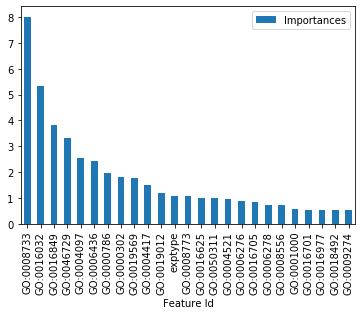

In [10]:
## plot bar plot
sub_cb_FeatureImportance_test.plot.bar(x='Feature Id', y='Importances', rot=90)

## 2. type='FeatureImportance', data=train_Pool

In [11]:
%%time
cb_FeatureImportance_train = model.get_feature_importance(data=train_Pool,
                       type='FeatureImportance',
                       prettified=True,
                       thread_count=-1,
                       verbose=False)

CPU times: user 1.44 s, sys: 167 ms, total: 1.6 s
Wall time: 1.47 s


In [12]:
## print the feature importance table with value > 0.5
sub_cb_FeatureImportance_train = cb_FeatureImportance_train.loc[cb_FeatureImportance_train['Importances']>0.5]
sub_cb_FeatureImportance_train.head()

,Feature Id,Importances
0,GO:0008733,8.046702
1,GO:0016032,5.297202
2,GO:0016849,3.951293
3,GO:0046729,3.425406
4,GO:0004097,2.500240


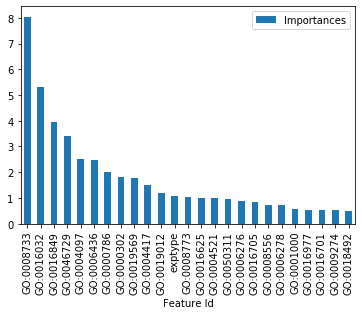

In [13]:
## plot bar plot
sub_cb_FeatureImportance_train.plot.bar(x='Feature Id', y='Importances', rot=90)

## 3. type='ShapValues', data=test_Pool

In [14]:
%%time
## Wall time: 30min 31s
## uncomment to run the code below, be careful about the time for running
# shap_values_catboost_test = model.get_feature_importance(data=test_Pool,
#                        type="ShapValues",
#                        prettified=True,
#                        thread_count=-1,
#                        verbose=False)
# np.save('shap_values_catboost_test.npy', shap_values_catboost_test , allow_pickle=True, fix_imports=True)

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 7.63 µs


In [15]:
shap_values_catboost_test = np.load('shap_values_catboost_test.npy', allow_pickle=True, fix_imports=True)
shap_values_catboost_test.shape

(8911, 90, 4404)

## 4. type='ShapValues', data=train_Pool

# ☣️Shap package method

### 1. shap valuse on test set

In [16]:
%%time
## Wall time: 30min 36s
# explainer_2 = shap.TreeExplainer(model)
# shap_values_2 = explainer.shap_values(X_test)
# ## save as pickle
# with open('shap_values_2.pkl', 'wb') as f:
#     pickle.dump(shap_values_2, f)

CPU times: user 4 µs, sys: 0 ns, total: 4 µs
Wall time: 8.34 µs


In [17]:
%%time
## Wall time: 30min 57s
# explainer_3 = shap.TreeExplainer(model)
# shap_values_3 = explainer.shap_values(X_test, y_test)
# with open('shap_values_3.pkl', 'wb') as f:
#     pickle.dump(shap_values_3, f)

CPU times: user 1 µs, sys: 3 µs, total: 4 µs
Wall time: 5.96 µs


In [8]:
with open('shap_values_2.pkl', 'rb') as f:
    shap_values_2 = pickle.load(f)

In [19]:
print(type(shap_values_2))
print(len(shap_values_2))
print(shap_values_2[0].shape)

<class 'list'>
90
(8911, 4403)


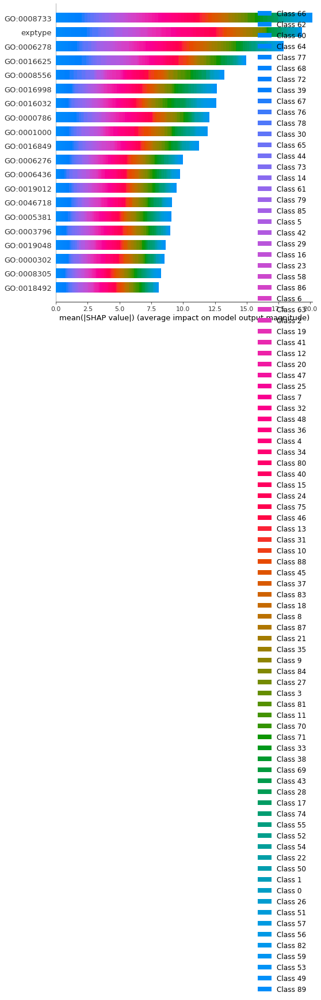

In [88]:
shap.summary_plot(shap_values_2, X_test)

### 2. shap values on train set

In [21]:
# %%time
## uncomment this cell to run code below
# ## time Wall time: 3h 39min 27s
# explainer_train = shap.TreeExplainer(model)
# shap_values_train = explainer_train.shap_values(X_train, y_train)
# with open('shap_values_train.pkl', 'wb') as f:
#     pickle.dump(shap_values_train, f)

In [9]:
%%time
with open('shap_values_train.pkl', 'rb') as f:
    shap_values_train = pickle.load(f)

CPU times: user 19.1 s, sys: 1min 49s, total: 2min 8s
Wall time: 2min 10s


## 🧬customized colormap

In [36]:
def generate_90_cmap():
    cmap_list = []
    for i in range(90):
        r = random.random()
        b = random.random()
        g = random.random()
        alpha = random.random()
        while alpha < 0.5:
            alpha = random.random()
        cmap_list.append((r, g, b, alpha))
    return colors.ListedColormap(cmap_list)
cmap = generate_90_cmap()

In [102]:
with open('color_map.pkl', 'wb') as f:
    pickle.dump(cmap, f)

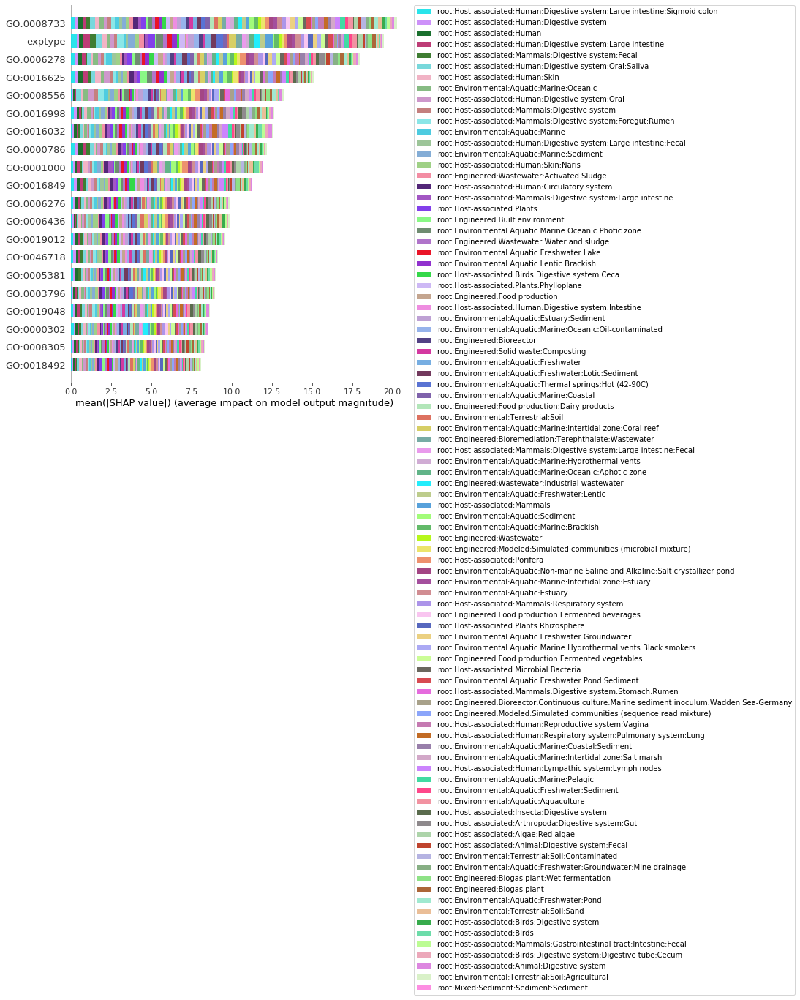

In [106]:
shap.summary_plot(shap_values_train, X_test, class_names=model.classes_, class_inds = "original", color=cmap, show=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)

## 🦠group biomes<br/>
This biome grouping on shap summary plot is a test, biomes are grouped directly by assigning the same color, the result might not accurate, because the shap values for grouped biomes should be their mean values instead of sum.<br/>
The mean valued group plot is in sort_stacked_bar_chart.ipynb

In [26]:
## create color map for grouped biomes
combined_color_map_list = ['SpringGreen']  * 2 + ['Violet'] * 4 + ['Red'] * 4 + ['DarkBlue'] * 2 + ['Turquoise'] + ['DarkOrange'] *4 + \
['Yellow']*13 + ['SteelBlue'] * 15 + ['Aquamarine'] * 3 + ['SlateBlue'] * 4 + ['Teal'] + ['Plum'] * 2 + ['YellowGreen'] + ['LightCyan'] * 4 + \
['Gold'] * 14 + ['ForestGreen'] + ['HotPink'] * 9 +['Khaki'] + ['Indigo'] * 3 + ['LavenderBlush'] + ['Brown']
combined_cmap = colors.ListedColormap(combined_color_map_list)

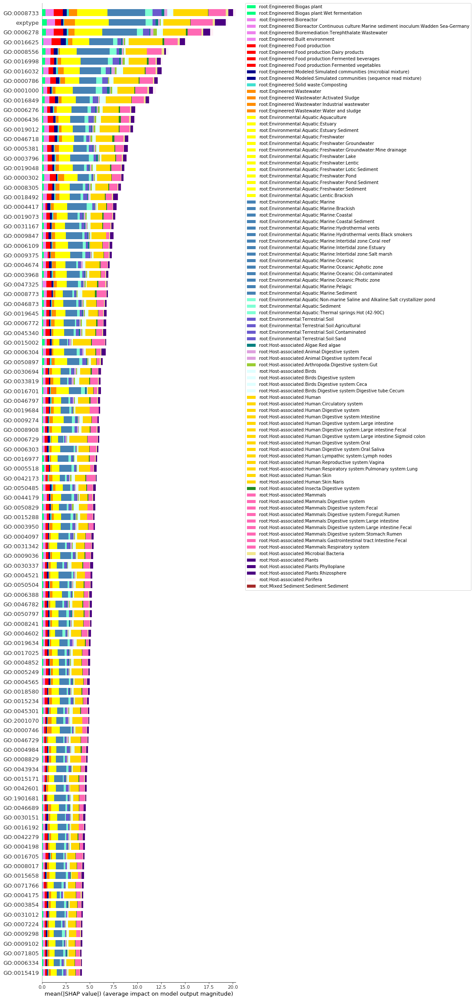

In [27]:
shap.summary_plot(shap_values_train, X_test, max_display=100, class_names=model.classes_, class_inds = "original", color=combined_cmap, show=False)
plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.)
plt.savefig('shap_summary_first_100.png',bbox_inches='tight')

### ℹ️nstance shap analysis <br/>


In [9]:
## ra
X_test.iloc[8743]

exptype       0.000000
GO:0043130    0.000000
GO:0055074    0.000000
GO:0055117    0.000000
GO:0046933    0.000650
                ...   
GO:0032183    0.000000
GO:0007618    0.000000
GO:0030097    0.000000
GO:0004520    0.001403
GO:0033739    0.001216
Name: 10513, Length: 4403, dtype: float64

In [15]:
X_test

,exptype,GO:0043130,GO:0055074,GO:0055117,GO:0046933,GO:0006302,GO:0008643,GO:0043752,GO:0007026,GO:0005976,...,GO:0019357,GO:0006527,GO:0004114,GO:0046423,GO:0034194,GO:0032183,GO:0007618,GO:0030097,GO:0004520,GO:0033739
8743,0,0.000000,0.0,0.00000,0.000010,0.000000,0.000000,0.000000,0.0,0.000000,...,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
72950,1,0.000856,0.0,0.03125,0.000014,0.000000,0.000000,0.000000,0.0,0.000000,...,0.000000,0.000000,0.001388,0.0,0.000000,0.0,0.0,0.0,0.000000,0.000000
21598,1,0.000000,0.0,0.00000,0.000024,0.000000,0.000000,0.002275,0.0,0.000019,...,0.000000,0.000026,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000362,0.000000
54760,0,0.000000,0.0,0.00000,0.000043,0.000000,0.000000,0.000000,0.0,0.000097,...,0.000000,0.000318,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000181,0.000094
1261,0,0.000000,0.0,0.00000,0.000034,0.000000,0.000000,0.000000,0.0,0.000000,...,0.000000,0.000000,0.000093,0.0,0.000000,0.0,0.0,0.0,0.000045,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
82563,0,0.000428,0.0,0.00000,0.000645,0.005690,0.000319,0.000927,0.0,0.000271,...,0.075472,0.000450,0.000000,0.0,0.000089,0.0,0.0,0.0,0.001267,0.000935
31982,0,0.000428,0.0,0.00000,0.001001,0.000948,0.000000,0.000927,0.0,0.000756,...,0.037736,0.001376,0.000093,0.0,0.000244,0.0,0.0,0.0,0.003122,0.004209
9611,0,0.000000,0.0,0.00000,0.000159,0.002371,0.000000,0.000000,0.0,0.000000,...,0.000000,0.000265,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000136,0.000468
43917,0,0.000000,0.0,0.00000,0.000226,0.000000,0.000000,0.000211,0.0,0.000349,...,0.000000,0.000370,0.000000,0.0,0.000000,0.0,0.0,0.0,0.000679,0.000842


In [43]:
first_X = X_test.iloc[8743].to_frame().transpose()
first_X['exptype'] = first_X['exptype'].astype(int)
first_X

,exptype,GO:0043130,GO:0055074,GO:0055117,GO:0046933,GO:0006302,GO:0008643,GO:0043752,GO:0007026,GO:0005976,...,GO:0019357,GO:0006527,GO:0004114,GO:0046423,GO:0034194,GO:0032183,GO:0007618,GO:0030097,GO:0004520,GO:0033739
10513,0,0.0,0.0,0.0,0.00065,0.004742,0.000639,0.001264,0.0,0.000233,...,0.113208,0.000582,0.0,0.0,0.000133,0.0,0.0,0.0,0.001403,0.001216


In [22]:
explainer = shap.TreeExplainer(model)
shap_values_8743 = explainer.shap_values(first_X)

In [52]:
pred_idx = np.where(model.classes_ == model.predict(first_X)[0][0])[0][0]
print(model.predict(first_X)[0][0], ':')
display(shap.force_plot(explainer.expected_value[pred_idx], shap_values_8743[pred_idx], first_X))

root:Host-associated:Mammals:Digestive system:Large intestine:Fecal :


In [53]:
for which_class in range(0,90):
    print(model.classes_[which_class])
    display(shap.force_plot(explainer.expected_value[which_class], shap_values_8743[which_class], first_X))

root:Engineered:Biogas plant


root:Engineered:Biogas plant:Wet fermentation


root:Engineered:Bioreactor


root:Engineered:Bioreactor:Continuous culture:Marine sediment inoculum:Wadden Sea-Germany


root:Engineered:Bioremediation:Terephthalate:Wastewater


root:Engineered:Built environment


root:Engineered:Food production


root:Engineered:Food production:Dairy products


root:Engineered:Food production:Fermented beverages


root:Engineered:Food production:Fermented vegetables


root:Engineered:Modeled:Simulated communities (microbial mixture)


root:Engineered:Modeled:Simulated communities (sequence read mixture)


root:Engineered:Solid waste:Composting


root:Engineered:Wastewater


root:Engineered:Wastewater:Activated Sludge


root:Engineered:Wastewater:Industrial wastewater


root:Engineered:Wastewater:Water and sludge


root:Environmental:Aquatic:Aquaculture


root:Environmental:Aquatic:Estuary


root:Environmental:Aquatic:Estuary:Sediment


root:Environmental:Aquatic:Freshwater


root:Environmental:Aquatic:Freshwater:Groundwater


root:Environmental:Aquatic:Freshwater:Groundwater:Mine drainage


root:Environmental:Aquatic:Freshwater:Lake


root:Environmental:Aquatic:Freshwater:Lentic


root:Environmental:Aquatic:Freshwater:Lotic:Sediment


root:Environmental:Aquatic:Freshwater:Pond


root:Environmental:Aquatic:Freshwater:Pond:Sediment


root:Environmental:Aquatic:Freshwater:Sediment


root:Environmental:Aquatic:Lentic:Brackish


root:Environmental:Aquatic:Marine


root:Environmental:Aquatic:Marine:Brackish


root:Environmental:Aquatic:Marine:Coastal


root:Environmental:Aquatic:Marine:Coastal:Sediment


root:Environmental:Aquatic:Marine:Hydrothermal vents


root:Environmental:Aquatic:Marine:Hydrothermal vents:Black smokers


root:Environmental:Aquatic:Marine:Intertidal zone:Coral reef


root:Environmental:Aquatic:Marine:Intertidal zone:Estuary


root:Environmental:Aquatic:Marine:Intertidal zone:Salt marsh


root:Environmental:Aquatic:Marine:Oceanic


root:Environmental:Aquatic:Marine:Oceanic:Aphotic zone


root:Environmental:Aquatic:Marine:Oceanic:Oil-contaminated


root:Environmental:Aquatic:Marine:Oceanic:Photic zone


root:Environmental:Aquatic:Marine:Pelagic


root:Environmental:Aquatic:Marine:Sediment


root:Environmental:Aquatic:Non-marine Saline and Alkaline:Salt crystallizer pond


root:Environmental:Aquatic:Sediment


root:Environmental:Aquatic:Thermal springs:Hot (42-90C)


root:Environmental:Terrestrial:Soil


root:Environmental:Terrestrial:Soil:Agricultural


root:Environmental:Terrestrial:Soil:Contaminated


root:Environmental:Terrestrial:Soil:Sand


root:Host-associated:Algae:Red algae


root:Host-associated:Animal:Digestive system


root:Host-associated:Animal:Digestive system:Fecal


root:Host-associated:Arthropoda:Digestive system:Gut


root:Host-associated:Birds


root:Host-associated:Birds:Digestive system


root:Host-associated:Birds:Digestive system:Ceca


root:Host-associated:Birds:Digestive system:Digestive tube:Cecum


root:Host-associated:Human


root:Host-associated:Human:Circulatory system


root:Host-associated:Human:Digestive system


root:Host-associated:Human:Digestive system:Intestine


root:Host-associated:Human:Digestive system:Large intestine


root:Host-associated:Human:Digestive system:Large intestine:Fecal


root:Host-associated:Human:Digestive system:Large intestine:Sigmoid colon


root:Host-associated:Human:Digestive system:Oral


root:Host-associated:Human:Digestive system:Oral:Saliva


root:Host-associated:Human:Lympathic system:Lymph nodes


root:Host-associated:Human:Reproductive system:Vagina


root:Host-associated:Human:Respiratory system:Pulmonary system:Lung


root:Host-associated:Human:Skin


root:Host-associated:Human:Skin:Naris


root:Host-associated:Insecta:Digestive system


root:Host-associated:Mammals


root:Host-associated:Mammals:Digestive system


root:Host-associated:Mammals:Digestive system:Fecal


root:Host-associated:Mammals:Digestive system:Foregut:Rumen


root:Host-associated:Mammals:Digestive system:Large intestine


root:Host-associated:Mammals:Digestive system:Large intestine:Fecal


root:Host-associated:Mammals:Digestive system:Stomach:Rumen


root:Host-associated:Mammals:Gastrointestinal tract:Intestine:Fecal


root:Host-associated:Mammals:Respiratory system


root:Host-associated:Microbial:Bacteria


root:Host-associated:Plants


root:Host-associated:Plants:Phylloplane


root:Host-associated:Plants:Rhizosphere


root:Host-associated:Porifera


root:Mixed:Sediment:Sediment:Sediment


## 👩‍💻scratch📝

In [76]:
cmap = colors.ListedColormap([(0,0,0), '#000000','#444444', '#666666', '#ffffff', 'blue', 'orange'])

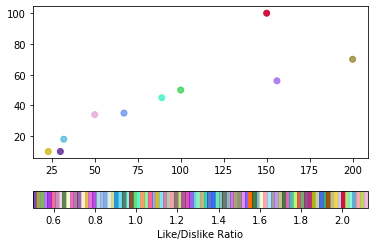

In [56]:
# cmap = 
purchaseCount = [100, 200, 150, 23, 30, 50,
                 156, 32, 67, 89]
  
# List of total likes of 10 products
likes = [50, 70, 100, 10, 10, 34, 56, 18, 35, 45]
  
# List of Like/Dislike ratio of 10 products
ratio = [1, 0.53, 2, 0.76, 0.5, 2.125, 0.56, 
         1.28, 1.09, 1.02]
  
# scatterplot
plt.scatter(x=purchaseCount, y=likes, c=ratio, cmap=cmap)
  
plt.colorbar(label="Like/Dislike Ratio", orientation="horizontal")
plt.show()

(0.7633148797353287, 0.46900439303857655, 0.6393967826277087)


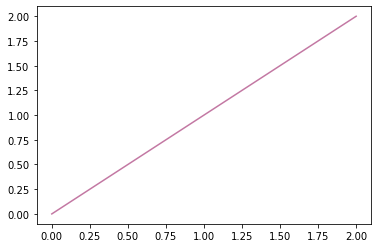

In [63]:
import random
x = [0, 1, 2]
y = [0, 1, 2]

r = random.random()
b = random.random()
g = random.random()
color = (r, g, b)
print(color)
plt.plot(x, y, c=color)

violet


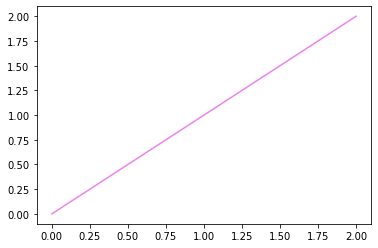

In [68]:
color = ('violet')
print(color)
plt.plot(x, y, c=color)
plt.show()

In [ ]:
with